# 1 Time Series 7-Day Forecasting with long short-term memory (LSTM) and embedding networks<a id='1_time_series_7-day_forecasting_with_lstm'></a>

## 1.1 Contents<a id='1.1_contents'></a>
* [1 Time series 7-day forecasting with LSTM](#1_time_series_7-day_forecasting_with_lstm)
  * [1.1 Contents](#1.1_contents)  
  * [1.2 Imports](#1.2_imports)
  * [1.3 Functions](#1.3_functions)
      * [1.3.1 Function: feature_list](#1.3.1_feature_list)
      * [1.3.2 Function: ebd_dim](#1.3.2_ebd_dim)
      * [1.3.3 Function: split_sequences](#1.3.3_split_sequences)
      * [1.3.4 Function: to_embed](#1.3.4_to_embed)
      * [1.3.5 Function: build_LSTM with embeddings](#1.3.5_build_lstm_with_embeddings)
      * [1.3.6 Function: ndarray_to_input_list](#1.3.6_ndarray_to_input_list)
      * [1.3.7 Function: ginic](#1.3.7_ginic)
      * [1.3.8 Function: gini_normalizedc](#1.3.8_gini_normalizedc)
      * [1.3.9 Functions: rmse_y_y_pred](#1.3.9_rmse_y_y_pred)
      * [1.3.10 Functions: plot_actual_predicted](#1.3.10_plot_actual_predicted)
  * [1.4 Load data](#1.4_load_data)   
  * [1.5 Preprocessing](#1.5_preprocessing)
      * [1.5.1 Preprocessing: get feature and target for model training and testing with cross-validation](#1.5.1_get_feature_target)
      * [1.5.2 Preprocessing: scale feature and target variables](#1.5.2_scale_feature_target)  
  * [1.6 Train and test the LSTM model](#1.6_train_test_model)
      * [1.6.1 Train and test the LSTM model: train and test with cross-validation](#1.6.1_train_test_crossvalidation)
      * [1.6.2 Summary and plot the model](#1.6.2_summary_plot_model)
  * [1.7 Organize and evaluate model performance](#1.7_organize_evaludate_model)
      * [1.7.1 Organize and evaluate model performance: train set](#1.7.1_organize_evaludate_model_train)
      * [1.7.2 Organize and evaluate model performance: validation set](#1.7.2_organize_evaludate_model_validation)
      * [1.7.3 Organize and evaluate model performance: test set](#1.7.3_organize_evaludate_model_test)
      * [1.7.4 Organize and evaluate model performance: save](#1.7.4_organize_evaludate_model_save)
      * [1.7.5 Organize and evaluate model performance: plot](#1.7.5_organize_evaludate_model_plot)

## 1.2 Imports<a id='1.2_imports'></a>

In [1]:
from google.colab import drive # (in Colab)
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Version control
!pip install pandas==1.3.2 
!pip install scipy==1.6.2
!pip install scikit-learn==0.24.2

In [1]:
import os
import pandas as pd
import numpy as np
import numpy.matlib
import matplotlib.pyplot as plt
import pickle
from pathlib import Path
from datetime import date, timedelta
import math
import warnings; warnings.simplefilter('ignore')

from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import TimeSeriesSplit
from sklearn.metrics import mean_squared_error

from keras.models import Model
from keras.layers import Input, Dense, Concatenate, Reshape, Dropout, LSTM, TimeDistributed
from keras.layers.embeddings import Embedding
from keras.utils.vis_utils import plot_model
from keras.callbacks import EarlyStopping

import tensorflow as tf
%load_ext tensorboard
import datetime, os

from contextlib import redirect_stdout
%matplotlib inline

# Set Matplotlib defaults
plt.style.use("seaborn-whitegrid")
plt.rc("figure", autolayout=True, figsize=(11, 5))
plt.rc(
    "axes",
    labelweight="bold",
    labelsize=14,
    titleweight="bold",
    titlesize=16,
    titlepad=10,
)
plot_params = dict(
    color="0.75",
    style=".-",
    markeredgecolor="0.25",
    markerfacecolor="0.25",
)

## 1.3 Functions<a id='1.3_functions'></a>

#### 1.3.1 Functions: feature_list <a id='1.3.1_feature_list'></a>

In [2]:
# organize features in each row into 1) static categorical, 2) temporal categorical, 3) temporal continuous
def feature_list(country_id, row): 
    # Static Categorical
    country = country_id #0 country id
    # Temporal Categorical (datetime variables)
    dt = row[0].to_pydatetime()
    year = dt.year #1
    month = dt.month #2
    day = dt.day #3
    week_of_year = dt.isocalendar()[1] #4
    day_of_week = row[1].dayow #5
    holiday = row[1].holiday #6 holiday
    # Temporal Continuous (mobility variables-this will be lagged for LSTM)
    # Temporal Continuous (weather variables)
    cloudcover = float(row[1].cloudcover) #13 weather; cloudcover
    tempC = float(row[1].tempC) #14 weather; temparature
    humidity = float(row[1].humidity) #15 weather; humidity
    precipMM = float(row[1].precipMM) #16 weather; precipitation
    # Temporal Continuous (vaccination-this will be lagged for LSTM)           
    return [country], \
[year, month, day, week_of_year, day_of_week, holiday], \
[cloudcover, tempC, humidity, precipMM] # Static Categorical, Temporal Categorical, Temporal Continuous

#### 1.3.2 Functions: ebd_dim <a id='1.3.2_ebd_dim'></a>

In [3]:
# determine the embedding dimensions
def ebd_dim(cat_dim):
    return min(600, round(1.6 * cat_dim ** .56))

#### 1.3.3 Functions: split_sequences <a id='1.3.3_split_sequences'></a>

In [4]:
# get the input and output sequences from the entire time series
def split_sequences(sequences, timestamp, n_steps_in, n_steps_out): 
    timestamps = sequences.index
    df_time0 = timestamps[0]
    df_time_end = timestamps[-1]
    dt_steps_in = timedelta(days=n_steps_in)
    dt_steps_out = timedelta(days=n_steps_out-1)   
    dt_1 = timedelta(days=1)
    if (timestamp-dt_steps_in>=df_time0) & (timestamp+dt_steps_out<=df_time_end): # if within bounds
        # gather input and output parts of the pattern 
        seq_x = sequences[timestamp-dt_steps_in:timestamp-dt_1] # input sequence (e.g. previous 14 days) 
        seq_y = sequences[timestamp:timestamp+dt_steps_out] # output sequence (e.g. next 7 days including the current timestamp)
    return list(seq_x), list(seq_y)

#### 1.3.4 Functions: to_embed <a id='1.3.4_to_embed'></a>

In [5]:
# preprocess the embedding columns
def to_embed(cat_columns): 
    
    cat_conv_raw = []
    cat_conv_array = np.empty((cat_columns.shape[0],cat_columns.shape[1]))
    
    for c in range(cat_columns.shape[1]):
        cat_conv_raw.append(list(cat_columns[:,c]))
        raw_vals = np.unique(cat_columns[:,c])
        val_map = {}
        for i in range(len(raw_vals)):
            val_map[raw_vals[i]] = i
        cat_conv_array[:,c] = [val_map[j] for j in cat_conv_raw[c]]
    return cat_conv_array

#### 1.3.5 Functions: build_LSTM_with_embeddings<a id='1.3.5_build_lstm_with_embeddings'></a>

In [6]:
def build_LSTM_with_embeddings(): 
    
    inputs = []
    embeddings = []
    input_dims = []
    
    input_stat_cat_00_country = Input(shape=(1,)) # country (0)
    inputs.append(input_stat_cat_00_country)
    input_dims.append(input_stat_cat_00_country.shape[-1])
    embedding = Embedding(23, 9, input_length=1)(input_stat_cat_00_country)
    embedding = Reshape(target_shape=(9,))(embedding)
    embeddings.append(embedding)
    
    input_temp_cat_01_year = Input(shape=(1,)) # year (1)
    inputs.append(input_temp_cat_01_year)
    input_dims.append(input_temp_cat_01_year.shape[-1])
    embedding = Embedding(2, 1, input_length=1)(input_temp_cat_01_year)
    embedding = Reshape(target_shape=(1,))(embedding)
    embeddings.append(embedding)
     
    input_temp_cat_02_month = Input(shape=(1,)) # month (2)
    inputs.append(input_temp_cat_02_month)
    input_dims.append(input_temp_cat_02_month.shape[-1])
    embedding = Embedding(12, 6, input_length=1)(input_temp_cat_02_month)
    embedding = Reshape(target_shape=(6,))(embedding)
    embeddings.append(embedding)    
    
    input_temp_cat_03_day = Input(shape=(1,)) # day (3)
    inputs.append(input_temp_cat_03_day)
    input_dims.append(input_temp_cat_03_day.shape[-1])
    embedding = Embedding(31, 11, input_length=1)(input_temp_cat_03_day)
    embedding = Reshape(target_shape=(11,))(embedding)
    embeddings.append(embedding)    
    
    input_temp_cat_04_week_of_year = Input(shape=(1,)) # week of year (4)
    inputs.append(input_temp_cat_04_week_of_year)
    input_dims.append(input_temp_cat_04_week_of_year.shape[-1])
    embedding = Embedding(53, 15, input_length=1)(input_temp_cat_04_week_of_year)
    embedding = Reshape(target_shape=(15,))(embedding)
    embeddings.append(embedding)
    
    input_temp_cat_05_day_of_week = Input(shape=(1,)) # day of week (5)
    inputs.append(input_temp_cat_05_day_of_week)
    input_dims.append(input_temp_cat_05_day_of_week.shape[-1])
    embedding = Embedding(7, 5, input_length=1)(input_temp_cat_05_day_of_week)
    embedding = Reshape(target_shape=(5,))(embedding)
    embeddings.append(embedding) 
    
    input_temp_cat_06_holiday = Input(shape=(1,)) # holiday (6)
    inputs.append(input_temp_cat_06_holiday)
    input_dims.append(input_temp_cat_06_holiday.shape[-1])
    embedding = Embedding(2, 2, input_length=1)(input_temp_cat_06_holiday)
    embedding = Reshape(target_shape=(2,))(embedding)
    embeddings.append(embedding)    
    
    input_weather = Input(shape=(4,)) # weather (temporal continuous) features without lagging (e.g. 4)
    inputs.append(input_weather)
    input_dims.append(input_weather.shape[-1])
    dense_weather = Dense(4)(input_weather)
    embeddings.append(dense_weather) 
    
    input_lstm = Input(shape=(14,8)) # input dim: batch size(omitted)-by-timesteps(14)-by-features(8; 6 mobility, vac, case) 
    inputs.append(input_lstm)
    input_dims.append(input_lstm.shape[-2]*input_lstm.shape[-1])
    
    x = Concatenate()(embeddings)
    x = Dense(90, activation='relu')(x)
    x = Dropout(.35)(x)
    x = Dense(40, activation='relu')(x)
    x = Dropout(.15)(x)
    x = Dense(14, activation='relu')(x)
    x = Dropout(.15)(x)
    
    lstm_ = LSTM(32, return_sequences=True, recurrent_dropout=0.1)(input_lstm) # output dim: (batch size-by-timesteps-by-hidden_size) 
    lstm_ = LSTM(64, return_sequences=True, recurrent_dropout=0.1)(lstm_) # output dim: (batch size-by-timesteps-by-hidden_size)
    lstm_ = TimeDistributed(Dense(16, activation='relu'))(lstm_)
    lstm_ = TimeDistributed(Dense(1, activation='relu'))(lstm_)
    lstm_ = Reshape((14,), input_shape=(None, 14, 1))(lstm_)
    
    x_lstm_ = Concatenate()([x, lstm_])
    x_lstm_ = Dense(14, activation='relu')(x_lstm_) 
    
    output = Dense(7, activation='linear')(x_lstm_)
    
    model = Model(inputs, output)
    
    model.compile(loss='mse', optimizer='adam', metrics=['mae'])
    
    return model, input_dims, inputs
# plot_model(model, to_file='lstm_embeddings_plot.png', show_shapes=True, show_layer_names=True)
# print(model.summary())

#### 1.3.6 Functions: ndarray_to_input_list <a id='1.3.6_ndarray_to_input_list'></a>

In [7]:
def ndarray_to_input_list(ndarr,input_dims,keras_input_list): 
    input_list = []
    input_dim_cumsum = list(np.cumsum(input_dims))
    input_dim_cumsum.insert(0,0)
    curr_input_0 = input_dim_cumsum[:-1]
    for i,input_0 in enumerate(curr_input_0):
        if len(keras_input_list[i].shape)==2: # if input is 2d (batch-by-feature), no reshaping is needed
            input_list.append(ndarr[:,input_0:input_0+input_dims[i]])
        elif len(keras_input_list[i].shape)==3: # if input is 3d (batch-by-timestep-by-feature), reshaping is needed 
            to_reshape = ndarr[:,input_0:input_0+input_dims[i]]
            n_timesteps = keras_input_list[i].shape[-2]
            n_features = keras_input_list[i].shape[-1]
            reshaped = np.empty((ndarr.shape[0], n_timesteps, n_features))
            for i in range(n_features):
                reshaped[:, :n_timesteps, i] = to_reshape[:,i*n_timesteps:(i*n_timesteps+n_timesteps)]
            input_list.append(reshaped)        
    return input_list

#### 1.3.7 Functions: ginic <a id='1.3.7_ginic'></a>

In [8]:
#gini scoring function from kernel at: 
#https://www.kaggle.com/tezdhar/faster-gini-calculation
def ginic(actual, pred):
    pred_arr = np.asarray(pred)
    if len(pred_arr.shape)==2: # matrix 
        pred_mean = pred.copy()
    elif len(pred_arr.shape)==3: # tuple 
        pred_mean = np.nanmean(pred_arr,axis=0) # average across cross-validation folds
    n, c = actual.shape[0], actual.shape[1]
    gini_sum = []
    for col in range(c):
        a_s = actual[np.argsort(pred_mean[:,col]),col] # returns the indices that would sort an array
        a_c = a_s.cumsum()
        gini_sum.append((a_c.sum() / a_c[-1] - (n + 1) / 2.0)/n) 
    return gini_sum

#### 1.3.8 Functions: gini_normalizedc <a id='1.3.8_gini_normalizedc'></a>

In [9]:
def gini_normalizedc(a, p):
    gini_a_p = ginic(a, p)
    gini_a_a = ginic(a, a)
    gini_norm = [gini_a_p[i]/gini_a_a[i] for i in range(len(gini_a_p))]
    return gini_norm

#### 1.3.9 Functions: rmse_y_y_pred <a id='1.3.9_rmse_y_y_pred'></a>

In [10]:
def rmse_y_y_pred(rez_dict, n_steps_out):
    rmse_dict = {}
    countries = sorted(set(rez_dict['country']))
    for country in countries:
        country_idx = [cc==country for cc in rez_dict['country']]
        country_rmse = []
        for d in range(n_steps_out):
            country_rmse.append(mean_squared_error(rez_dict['y'][country_idx,d], rez_dict['y_pred'][country_idx,d], squared=False))
        rmse_dict[country] = country_rmse
    return rmse_dict 

#### 1.3.10 Functions: plot_actual_predicted <a id='1.3.10'></a>

In [8]:
def plot_actual_predicted(rez_dict, dict_country, save_name, n_steps_out=7):
    countries = sorted(set(rez_dict['country']))
    # plot for each of the 7-day forecast
    for country in countries:
        fig, ax = plt.subplots(n_steps_out, 1, figsize=(12, 36))
        fig.subplots_adjust(wspace=0.5, hspace=0.7)
        
        country_idx = [cc==country for cc in rez_dict['country']]
        timestamps = [i for i,v in zip(rez_dict['timestamp'],country_idx) if v]
        
        holidays = np.array(dict_country[country].loc[timestamps, 'holiday']==1) # holidays
        sundays = np.array(dict_country[country].loc[timestamps, 'dayow']==6) # Sundays
        holi_sun = np.logical_or(holidays, sundays)
        holiday_timestamps = [date.strftime(i, '%b-%d') for i,v in zip(rez_dict['timestamp'],holi_sun) if v]
        
        y_actual = rez_dict['y'][country_idx,:]
        y_pred = rez_dict['y_pred'][country_idx,:]
        
        for i in range(n_steps_out):
            ts_td = [t+timedelta(days=i) for t in timestamps]
            ts = list(map(lambda x:date.strftime(x,'%y-%b-%d'),ts_td))   
            
            if save_name == 'train':
                interval = 28
            elif save_name == 'val':
                interval = 14
            elif save_name == 'test':
                interval = 2
            
            ts_td_interval = [ts for i, ts in enumerate(ts_td) if i in np.arange(0, len(ts_td), interval)]
            ts_interval = list(map(lambda x:date.strftime(x,'%y-%b-%d'),ts_td_interval))     
            
            ax[i].plot(ts, y_actual[:,i], 'o-')
            ax[i].plot(ts, y_pred[:,i], 'o-')
            ax[i].xaxis.set_ticks(ts_interval)
            ax[i].set_xlabel('Date', fontsize=14, fontweight='bold')
            #ax[i].set_xlim(ts[0], ts[-1])
            ax[i].set_ylabel('Cases per million', fontsize=14, fontweight='bold')          
            ax[i].set_title(country + '_step_#' + str(i), fontweight='bold', fontsize=20)
            ax[i].legend(['y_actual','y_pred'], prop=dict(weight='bold',size=12))
            for tick in ax[i].get_xticklabels():
                tick.set_rotation(45)
            ax[i].tick_params(axis='x', labelsize=12)
            ax[i].tick_params(axis='y', labelsize=12)
            #for holi in holiday_timestamps:
            #    ax[i].axvspan(holi, holi, color='red', alpha=0.3, linewidth=2)
        # figure save
        fig.savefig(os.path.join('/Users/parkj/Documents/pyDat/dataSet/covid19_forecasting/covid19_figures/LSTM', \
                                  country+'_'+save_name+'_LSTM_7d.pdf'), tranparent=True)
        #fig.savefig(os.path.join('/content/drive/My Drive/Colab_data/covid19/Figure', \
        #                         country+'_'+save_name+'_MLP_7d.pdf'), tranparent=True)

In [12]:
def split_sequence_features(df_country, ts_curr): 
    f_rtrc, _ = split_sequences(df_country['rtrc'], ts_curr, n_steps_in=14, n_steps_out=0)  
    f_grph, _ = split_sequences(df_country['grph'], ts_curr, n_steps_in=14, n_steps_out=0)
    f_prks, _ = split_sequences(df_country['prks'], ts_curr, n_steps_in=14, n_steps_out=0)   
    f_tran, _ = split_sequences(df_country['tran'], ts_curr, n_steps_in=14, n_steps_out=0)   
    f_work, _ = split_sequences(df_country['work'], ts_curr, n_steps_in=14, n_steps_out=0)
    f_resi, _ = split_sequences(df_country['resi'], ts_curr, n_steps_in=14, n_steps_out=0)
    f_vac, _ = split_sequences(df_country['vac'], ts_curr, n_steps_in=14, n_steps_out=0)
    f_case, t_case = split_sequences(df_country['case_mil'], ts_curr, n_steps_in=14, n_steps_out=7)    
    return f_rtrc, f_grph, f_prks, f_tran, f_work, f_resi, f_vac, f_case, t_case

## 1.4 Load data<a id='1.4_load_data'></a>

In [10]:
# load data from pickle file
filePath_pickle = Path('/Users/parkj/Documents/pyDat/dataSet/covid_country_data.pickle')
with open(filePath_pickle, 'rb') as f:
    dict_country = pickle.load(f)
# countries = ['AR', 'AT', 'AU', 'BE', 'CA', 'DE', 'DK', 'FI', 'FR', 'GB', 'ID', 'IE', 'IL', 'IN', 'IT', 'JP', 'KR', 'MX', 'NL', 'NO', 'RU', 'SG', 'US']

## 1.5 Preprocessing <a id='1.5_Preprocessing'></a>

#### 1.5.1 Preprocessing: get feature and target for model training and testing with cross-validation <a id='1.5.1_get_feature_target'></a>

In [14]:
train_timestamp = []
train_country = []
train_stat_cat = []
train_temp_cat = []
train_temp_con = []
train_f_rtrc = []
train_f_grph = []
train_f_prks = []
train_f_tran = []
train_f_work = []
train_f_resi = []
train_f_vac = []
train_f_case = []
train_y_unscaled = []

test_timestamp = []
test_country = []
test_stat_cat = []
test_temp_cat = []
test_temp_con = []
test_f_rtrc = []
test_f_grph = []
test_f_prks = []
test_f_tran = []
test_f_work = []
test_f_resi = []
test_f_vac = []
test_f_case = []
test_y_unscaled = []

n_test = 21 # days
dt_test = timedelta(days=n_test-1)
n_steps_in = 14 # days (# previous cases)
dt_steps_in = timedelta(days=n_steps_in)
n_steps_out = 7 # days (# future cases to be predicted)
dt_steps_out = timedelta(days=n_steps_out-1)

for i, country_key in enumerate(dict_country.keys()):
    case_detection = 0
    df_country = dict_country[country_key]
    df_country.fillna(method='ffill',inplace=True) # forward fill NaNs
    df_time0 = df_country.index[0] # the first day of the data
    df_time_end = df_country.index[-1] # the last day of the data
    # split the df into train and test sets
    test_time0 = df_country.index[-1]-dt_test # the first date of test set 
    train_ind = df_country.index < test_time0 # training index
    # feature_list train 
    df_country_train = df_country.loc[train_ind] # train df
    for row in df_country_train.iterrows():
        ts_curr = row[0] 
        # case_mil lagging
        if (ts_curr-dt_steps_in>=df_time0) & (ts_curr+dt_steps_out<=df_time_end):
            # get feature and target variables
            f_rtrc, f_grph, f_prks, f_tran, f_work, f_resi, f_vac, f_case, t_case = split_sequence_features(df_country, ts_curr)     
            if (case_detection == 0) & (sum(f_case)>0): # to exclude days before 1st case detection
                case_detection = 1
            if case_detection == 1:
                fl_stat_cat, fl_temp_cat, fl_temp_con = feature_list(i, row) # get static categorical, temporal categorical, temporal continuous variables separately 
                # train data X (for embeddings)
                train_country.append(row[1].country_region_code)
                train_timestamp.append(ts_curr) # timestamps
                train_stat_cat.append(fl_stat_cat) # static categorical 
                train_temp_cat.append(fl_temp_cat) # temporal categorical 
                train_temp_con.append(fl_temp_con) # temporal continuous
                # train data X (for LSTM)
                train_f_rtrc.append(f_rtrc)
                train_f_grph.append(f_grph)
                train_f_prks.append(f_prks)
                train_f_tran.append(f_tran)
                train_f_work.append(f_work)
                train_f_resi.append(f_resi)
                train_f_vac.append(f_vac)
                train_f_case.append(f_case) # case_mil previous days to be used as features
                # train data y
                train_y_unscaled.append(t_case) # case_mil current & future days to be predicted
    # feature list test
    df_country_test = df_country.loc[~train_ind] # test df
    # feature list test 
    for row in df_country_test.iterrows():
        ts_curr = row[0]
        # case_mil lagging
        if (ts_curr-dt_steps_in>=df_time0) & (ts_curr+dt_steps_out<=df_time_end):        
            # get feature and target variables
            f_rtrc, f_grph, f_prks, f_tran, f_work, f_resi, f_vac, f_case, t_case = split_sequence_features(df_country, ts_curr)   
            fl_stat_cat, fl_temp_cat, fl_temp_con = feature_list(i, row) # get static categorical, temporal categorical, temporal continuous variables separately
            # test data X (for embeddings)
            test_country.append(row[1].country_region_code)
            test_timestamp.append(ts_curr)
            test_stat_cat.append(fl_stat_cat) # static categorical 
            test_temp_cat.append(fl_temp_cat) # temporal categorical 
            test_temp_con.append(fl_temp_con) # temporal continuous
            # test data X (for LSTM)
            test_f_rtrc.append(f_rtrc)
            test_f_grph.append(f_grph)
            test_f_prks.append(f_prks)
            test_f_tran.append(f_tran)
            test_f_work.append(f_work)
            test_f_resi.append(f_resi)
            test_f_vac.append(f_vac)      
            test_f_case.append(f_case) # case_mil previous days to be used as features
            # train data y
            test_y_unscaled.append(t_case) # case_mil current & future days to be predicted

#### 1.5.2 Preprocessing: scale or embed feature and target variables <a id='1.5.2_scale_feature_target'></a>

In [15]:
def matrix_scaler_over_all_columns(input_list, scaler_):
    concat_1d = []
    for m in input_list:
        concat_1d.append(np.reshape(m, (np.shape(m)[0]*np.shape(m)[1],1)))
    concat_1d_array = np.concatenate(concat_1d, axis=0)
    
    output_list = []
    for m in input_list:
        repmat = np.matlib.repmat(concat_1d_array, 1, np.shape(m)[1])
        #scaler_ = StandardScaler()
        scaler_.fit(repmat)
        output_list.append(scaler_.transform(m))       
    return output_list, scaler_

In [16]:
def matrix_scaler_each_column(input_list, scaler_):
    concat = np.concatenate(input_list, axis=0)
    scaler_.fit(concat)
    output_list = []
    for m in input_list:
        output_list.append(scaler_.transform(m))       
    return output_list

In [17]:
# embed static categorical 
train_stat_cat_embed = to_embed(np.array(train_stat_cat))
test_stat_cat_embed = to_embed(np.array(test_stat_cat))
# embed temporal categorical 
train_temp_cat_embed = to_embed(np.array(train_temp_cat))
test_temp_cat_embed = to_embed(np.array(test_temp_cat))
# scale temporal continuous
temp_con_scaled = matrix_scaler_each_column([train_temp_con, test_temp_con], MinMaxScaler())
train_temp_con_scaled = temp_con_scaled[0]
test_temp_con_scaled = temp_con_scaled[1]
# scale lagged temporal continuous (for LSTM)
# rtrc
rtrc_scaled, _ = matrix_scaler_over_all_columns([train_f_rtrc, test_f_rtrc], MinMaxScaler())
train_rtrc_scaled = rtrc_scaled[0]
test_rtrc_scaled = rtrc_scaled[1]
# grph
grph_scaled, _ = matrix_scaler_over_all_columns([train_f_grph, test_f_grph], MinMaxScaler())
train_grph_scaled = grph_scaled[0]
test_grph_scaled = grph_scaled[1]
# prks
prks_scaled, _ = matrix_scaler_over_all_columns([train_f_prks, test_f_prks], MinMaxScaler())
train_prks_scaled = prks_scaled[0]
test_prks_scaled = prks_scaled[1]
# tran
tran_scaled, _ = matrix_scaler_over_all_columns([train_f_tran, test_f_tran], MinMaxScaler())
train_tran_scaled = tran_scaled[0]
test_tran_scaled = tran_scaled[1]
# work
work_scaled, _ = matrix_scaler_over_all_columns([train_f_work, test_f_work], MinMaxScaler())
train_work_scaled = work_scaled[0]
test_work_scaled = work_scaled[1]
# resi
resi_scaled, _ = matrix_scaler_over_all_columns([train_f_resi, test_f_resi], MinMaxScaler())
train_resi_scaled = resi_scaled[0]
test_resi_scaled = resi_scaled[1]
# vac
vac_scaled, _ = matrix_scaler_over_all_columns([train_f_vac, test_f_vac], MinMaxScaler())
train_vac_scaled = vac_scaled[0]
test_vac_scaled = vac_scaled[1]
# case
case_scaled, scaler_y = matrix_scaler_over_all_columns([train_f_case, test_f_case, train_y_unscaled, test_y_unscaled], StandardScaler())
train_f_case_scaled = case_scaled[0]
test_f_case_scaled = case_scaled[1]
train_y = case_scaled[2]
test_y = case_scaled[3]

# concatenate features to get X
train_X = np.concatenate((train_stat_cat_embed, train_temp_cat_embed, train_temp_con_scaled, \
                          train_rtrc_scaled, train_grph_scaled, train_prks_scaled, train_tran_scaled, \
                          train_work_scaled, train_resi_scaled, train_vac_scaled, train_f_case_scaled), axis=1)

test_X = np.concatenate((test_stat_cat_embed, test_temp_cat_embed, test_temp_con_scaled, \
                         test_rtrc_scaled, test_grph_scaled, test_prks_scaled, test_tran_scaled, \
                         test_work_scaled, test_resi_scaled, test_vac_scaled, test_f_case_scaled), axis=1)
print("Number of train datapoints: ", len(train_y))
print("Number of test datapoints: ", len(test_y))

Number of train datapoints:  12541
Number of test datapoints:  345


## 1.6 Train and test the LSTM model with embeddings <a id='1.6_train_test_lstm_model'></a>

#### 1.6.0 Start tensorboard

In [18]:
logs_base_dir = "./logs"
os.makedirs(logs_base_dir, exist_ok=True)
%tensorboard --logdir {logs_base_dir}
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=logs_base_dir, histogram_freq=1)

Output hidden; open in https://colab.research.google.com to view.

#### 1.6.1 Train and test the LSTM model: train and test with cross-validation <a id='1.6.1_train_test_crossvalidation'></a>

In [ ]:
# get the cross-validation folds for train and validation sets  
train_folds = []
validation_folds = []
# get the timestamps for train and validation folds
sorted_train_timestamp = sorted((set(train_timestamp))) # unique timestamps in the train set
tscv = TimeSeriesSplit(n_splits=5, test_size=21) # splitting train and validations sets for cross validation
for train_idx, validation_idx in tscv.split(sorted_train_timestamp): # get train and validation sets
    # print("TRAIN:", train_idx, "VALIDATION:", validation_idx)
    train_folds.append([sorted_train_timestamp[i] for i in train_idx]) # folds in train set
    validation_folds.append([sorted_train_timestamp[i] for i in validation_idx]) # folds in validation set

n_epochs = 1000
runs_per_fold = 5

cv_ginis = []
train_preds = []
train_idx_fold = [] 
val_preds = []
val_idx_fold = []
test_preds = []

# network training
for fold in range(len(train_folds)): # iterate cross-validation folds
    fold_idx_train = [ts in train_folds[fold] for ts in train_timestamp]
    train_idx_fold.append(fold_idx_train)
    fold_idx_val = [ts in validation_folds[fold] for ts in train_timestamp]
    val_idx_fold.append(fold_idx_val)
    X_train_f, X_val_f = train_X[fold_idx_train,:], train_X[fold_idx_val,:] # X_train for the current fold
    y_train_f, y_val_f = train_y[fold_idx_train,:], train_y[fold_idx_val,:] # y_train for the current fold
    
    train_preds_fold = []
    val_preds_fold = []
    
    for run_n in range(runs_per_fold): # iterate # of runs per fold
        # build the model
        NN, input_dim_NN, keras_input_list = build_LSTM_with_embeddings() # build the model and get input dimensions
        
        X_train_f_input = ndarray_to_input_list(X_train_f, input_dim_NN, keras_input_list)
        X_val_f_input = ndarray_to_input_list(X_val_f, input_dim_NN, keras_input_list)
        X_test_f_input = ndarray_to_input_list(test_X, input_dim_NN, keras_input_list)
        
        NN.fit(X_train_f_input, y_train_f, epochs=n_epochs, batch_size=2048, verbose=2, \
               callbacks = [EarlyStopping(monitor="loss", min_delta = 0.00001, patience = 50, mode = 'auto', restore_best_weights=True), tensorboard_callback])
   
        train_preds_fold.append(NN.predict(X_train_f_input))
        val_preds_fold.append(NN.predict(X_val_f_input))
        test_preds.append(NN.predict(X_test_f_input))
    
    cv_gini = gini_normalizedc(y_val_f, val_preds_fold) # actual, predicted
    cv_ginis.append(cv_gini)
    for i, cvg in enumerate(cv_gini):
        print('\nFold %d prediction cv gini_%d: %.5f\n' %(fold,i,cv_gini[i]))
    
    train_preds.append(np.mean(np.asarray(train_preds_fold),axis=0)) # ave
    val_preds.append(np.mean(np.asarray(val_preds_fold),axis=0))
    
cv_gini_mean = np.nanmean(np.asarray(cv_ginis),axis=0)
for i, g in enumerate(cv_gini_mean):
    print('Mean validation fold gini_%d: %.5f\n' %(i,g))

test_y_pred = np.nanmean(np.asarray(test_preds),axis=0) # average across cross-validation folds and runs

#### 1.6.2 Summary and plot the LSTM model <a id='1.6.2_summary_plot_model'></a>

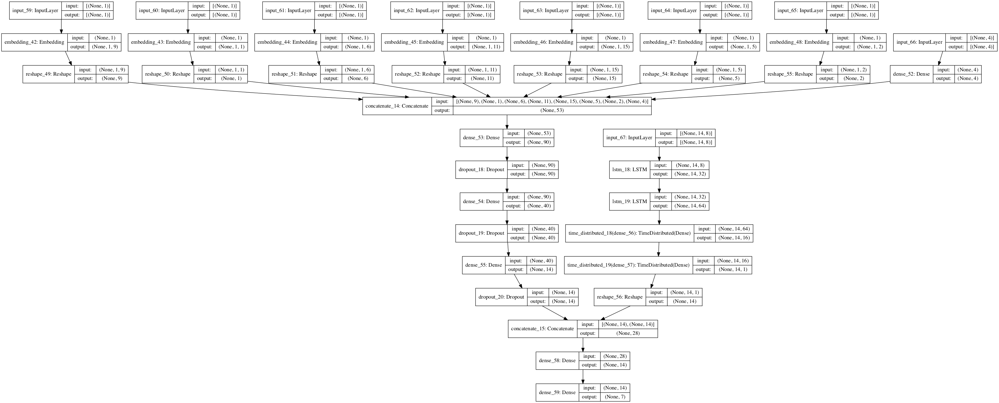

In [ ]:
plot_model(NN, to_file='lstm_embeddings_plot.png', show_shapes=True, show_layer_names=True)

In [ ]:
print(NN.summary())
with open('model_summary_lstm_embeddings.txt', 'w') as f:
    with redirect_stdout(f):
        NN.summary()

## 1.7 Organize and evaluate model performance <a id='1.7_organize_evaludate_model'></a>

#### 1.7.1 Organize and evaluate model performance: train set <a id='1.7.1_organize_evaludate_model_train'></a>

In [22]:
# average train_preds across folds to get train_y_pred
train_y_pred_fold = np.empty((len(train_idx_fold[0]), n_steps_out, len(train_idx_fold)))
train_y_pred_fold[:]=np.NaN
for i, train_idx in enumerate(train_idx_fold): 
    train_y_pred_fold[train_idx,:,i] = train_preds[i]
train_y_pred = np.nanmean(train_y_pred_fold, axis=2)

rez_LSTM_7d_train = {}
train_set_idx = np.isnan(train_y_pred).sum(axis=1)==0
rez_LSTM_7d_train['timestamp'] = [train_timestamp[i] for i, logic in enumerate(train_set_idx) if logic ==True]
rez_LSTM_7d_train['country'] = [train_country[i] for i, logic in enumerate(train_set_idx) if logic ==True]
rez_LSTM_7d_train['X'] = train_X[train_set_idx,:] # note that variables are scaled and preprocessed for embedding 
rez_LSTM_7d_train['y'] = scaler_y.inverse_transform(train_y)[train_set_idx,:] # back to the original unit (cases per million)
rez_LSTM_7d_train['y_pred'] = scaler_y.inverse_transform(train_y_pred)[train_set_idx,:] 
rez_LSTM_7d_train['rmse'] = rmse_y_y_pred(rez_LSTM_7d_train, n_steps_out)

#### 1.7.2 Organize and evaluate model performance: validation set <a id='1.7.2_organize_evaludate_model_validation'></a>

In [23]:
# average val_preds across folds to get val_y_pred
val_y_pred_fold = np.empty((len(train_idx_fold[0]), n_steps_out, len(train_idx_fold)))
val_y_pred_fold[:]=np.NaN
for i, val_idx in enumerate(val_idx_fold): 
    val_y_pred_fold[val_idx,:,i] = val_preds[i]
val_y_pred = np.nanmean(val_y_pred_fold, axis=2)

rez_LSTM_7d_val = {}
val_set_idx = np.isnan(val_y_pred).sum(axis=1)==0
rez_LSTM_7d_val['timestamp'] = [train_timestamp[i] for i, logic in enumerate(val_set_idx) if logic ==True]
rez_LSTM_7d_val['country'] = [train_country[i] for i, logic in enumerate(val_set_idx) if logic ==True]
rez_LSTM_7d_val['X'] = train_X[val_set_idx,:] # note that variables are scaled and preprocessed for embedding 
rez_LSTM_7d_val['y'] = scaler_y.inverse_transform(train_y)[val_set_idx,:] # back to the original unit (cases per million)
rez_LSTM_7d_val['y_pred'] = scaler_y.inverse_transform(val_y_pred)[val_set_idx,:] 
rez_LSTM_7d_val['rmse'] = rmse_y_y_pred(rez_LSTM_7d_val, n_steps_out)

#### 1.7.3 Organize and evaluate model performance: test set <a id='1.7.3_organize_evaludate_model_test'></a>

In [24]:
rez_LSTM_7d_test = {}
rez_LSTM_7d_test['timestamp'] = test_timestamp
rez_LSTM_7d_test['country'] = test_country
rez_LSTM_7d_test['X'] = test_X # note that variables are scaled and preprocessed for embedding 
rez_LSTM_7d_test['y'] = scaler_y.inverse_transform(test_y)
rez_LSTM_7d_test['y_pred'] = scaler_y.inverse_transform(test_y_pred)
rez_LSTM_7d_test['rmse'] = rmse_y_y_pred(rez_LSTM_7d_test, n_steps_out)

#### 1.7.4 Organize and evaluate model performance: save data<a id='1.7.4_organize_evaludate_model_save'></a>

In [25]:
rez_LSTM_7d = {'train':rez_LSTM_7d_train, 'validation':rez_LSTM_7d_val, 'test':rez_LSTM_7d_test}

filePath_pickle = Path('/content/drive/My Drive/Colab_data/covid19/covid19_LSTM_7d_with_lagging_shorter_test_period_colab.pickle')
with open(filePath_pickle, 'wb') as f:
    pickle.dump(rez_LSTM_7d, f)

In [29]:
#load the saved dictionary from pickle file
#filePath_pickle = Path('/content/drive/My Drive/Colab_data/covid19/covid19_LSTM_7d_with_lagging_shorter_test_period_colab.pickle')
#with open(filePath_pickle, 'rb') as f:
#     rez_LSTM_7d = pickle.load(f)

#### 1.7.5 Organize and evaluate model performance: plot <a id='1.7.5_organize_evaludate_model_plot'></a>

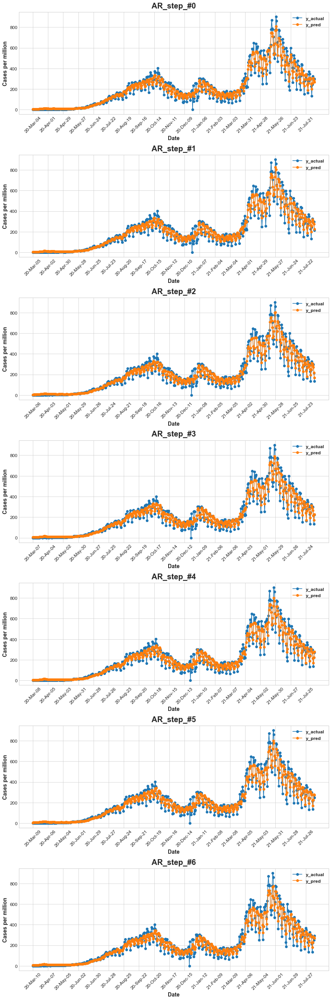

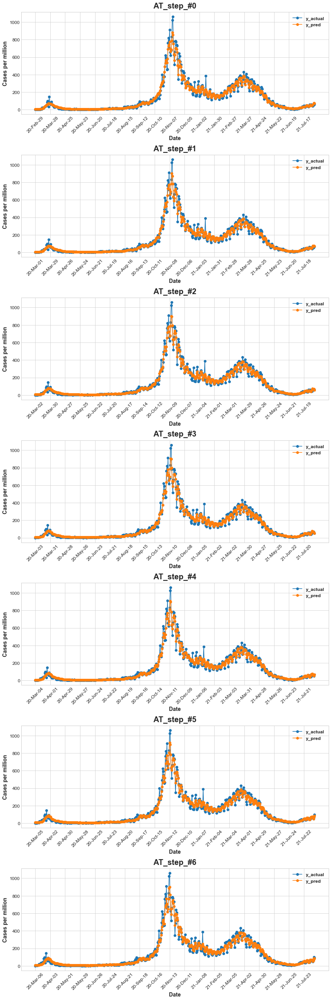

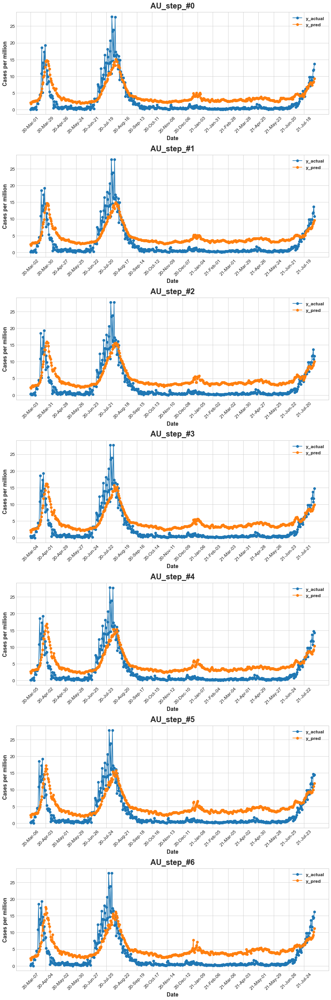

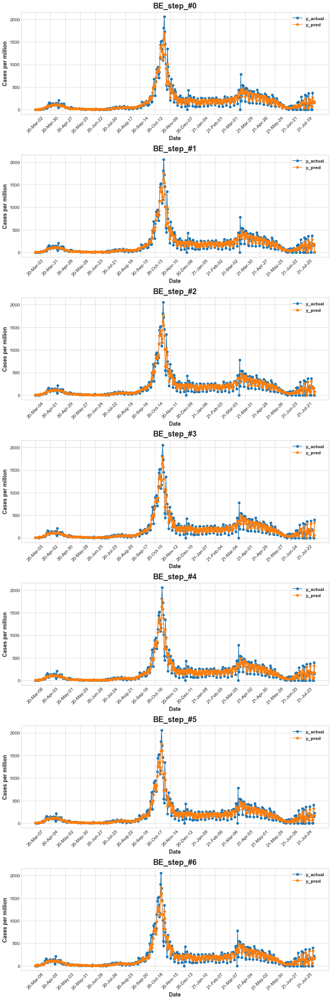

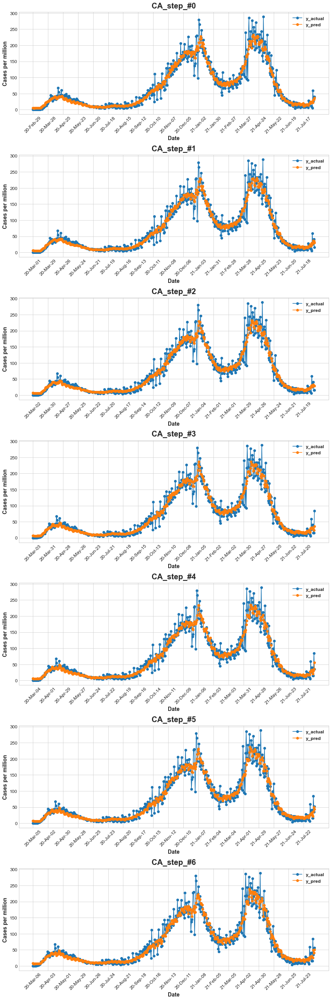

...

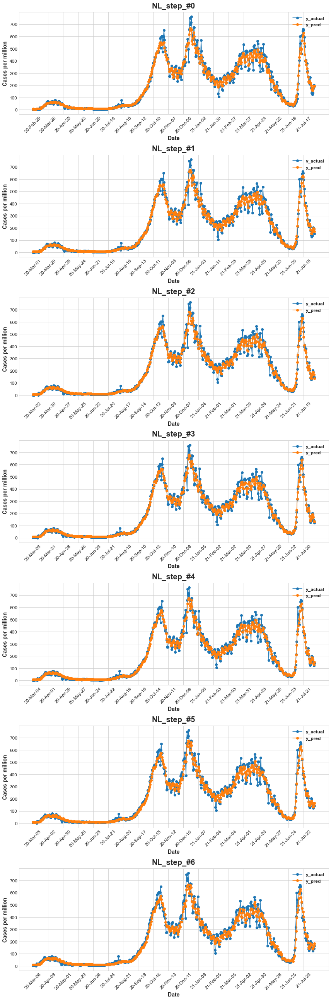

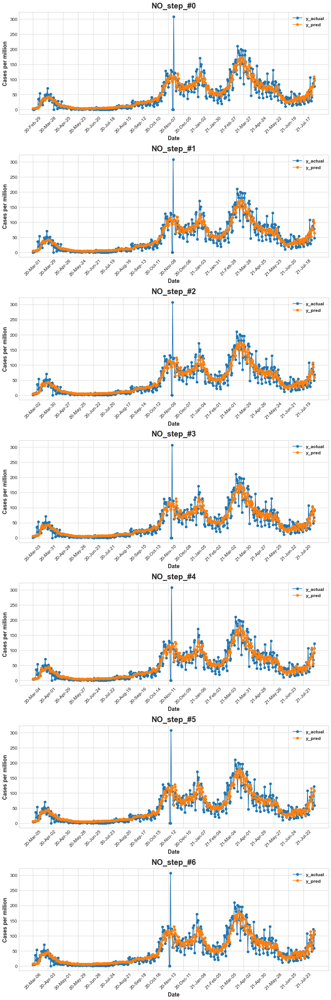

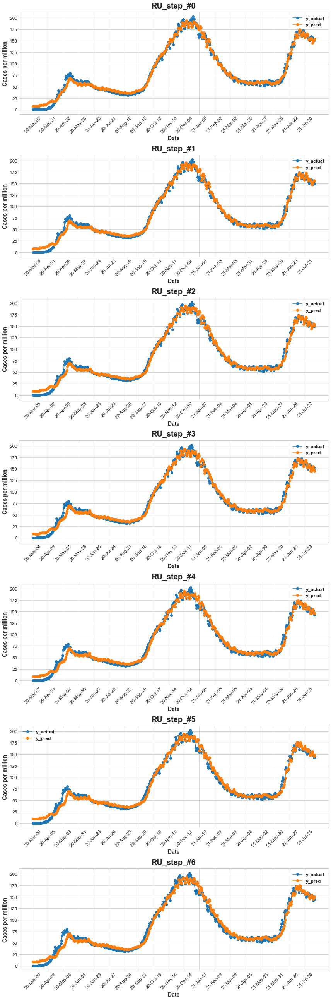

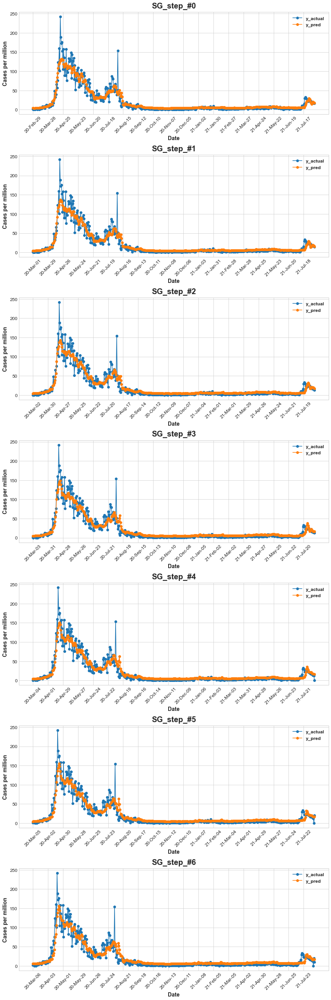

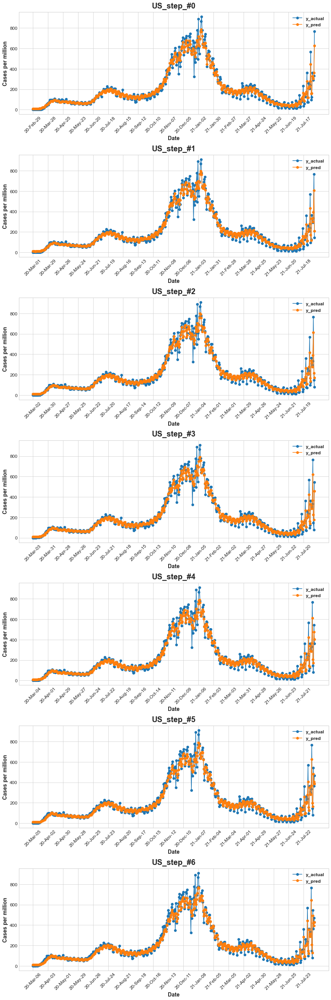

In [16]:
plot_actual_predicted(rez_LSTM_7d['train'], dict_country, 'train', n_steps_out=7)

#### 1.7.6 Analyze tensorboard data

In [ ]:
# upload tensorboard data to dev to make it publicly available
!tensorboard dev upload --logdir ./logs \
  --name "multivariate_timeseries_energy_usage" \
  --description "Training results from /Volumes/GoogleDrive/My Drive/Colab Notebooks/multivariate_timeseries_analysis_energy_usage_.ipynb" \
  --one_shot

In [ ]:
# if the above upload is successful, the specific experiment sould be listed using the command below
!tensorboard dev list

In [ ]:
# the following describes how to get the tensorboard experiment data as pandas dataframe using the api (https://www.tensorflow.org/tensorboard/dataframe_api)
import tensorboard as tb
experiment_id = "c1KCv3X3QvGwaXfgX1c4tg" # get the proper experiment id
experiment = tb.data.experimental.ExperimentFromDev(experiment_id)
df = experiment.get_scalars()